In [1]:
import torch

In [2]:
torch.cuda.is_available()

True

Number of files:  186
Maximum segment length:  45784
Final reshaped tensor shape:  torch.Size([186, 5, 45784, 4])


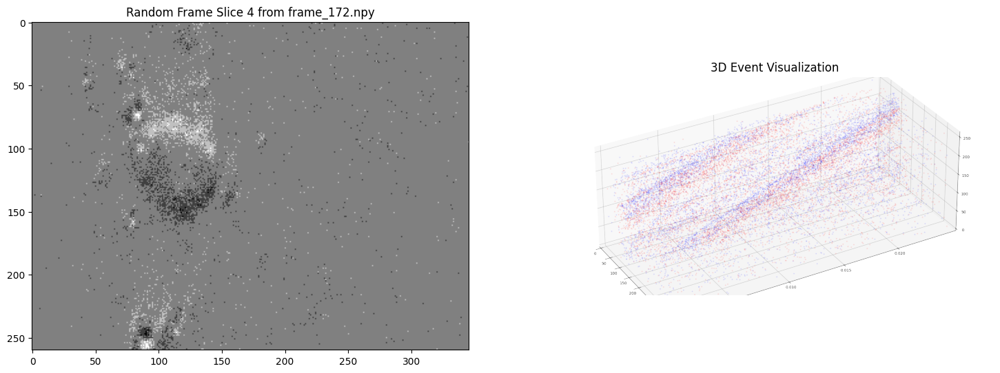

Deleted temporary CSV /tmp/tmpzuyh5mjc.csv and event plot /tmp/tmpjqqaevsi.png


24it [00:18,  1.29it/s]


Epoch 1, Loss: -0.2747460299481948


24it [00:18,  1.29it/s]


Epoch 2, Loss: -0.3948366815845172


24it [00:18,  1.29it/s]


Epoch 3, Loss: -0.4723885307709376


24it [00:18,  1.29it/s]


Epoch 4, Loss: -0.6060249209403992


24it [00:18,  1.29it/s]


Epoch 5, Loss: -0.7120932042598724


24it [00:18,  1.29it/s]


Epoch 6, Loss: -0.7948933045069376


24it [00:18,  1.29it/s]


Epoch 7, Loss: -0.8336048026879629


24it [00:18,  1.27it/s]


Epoch 8, Loss: -0.822787473599116


15it [00:12,  1.19it/s]

KeyboardInterrupt



In [1]:
# Imports
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import random
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset
from tqdm import tqdm
from datetime import datetime, timedelta
import pandas as pd
import tempfile
from frame2event import Frame2Event
from event_visualizer import EventVisualizer
from tqdm import tqdm 
from skimage.io import imsave
from random import choice
import inspect
import re


# print(os.environ["CUDA_VISIBLE_DEVICES"])
os.environ["CUDA_VISIBLE_DEVICES"]="1"

# Set random seed for reproducibility
random.seed(23)
torch.manual_seed(23)
np.random.seed(23)


# Set default tensor type to float32
torch.set_default_dtype(torch.float32)

torch.autograd.set_detect_anomaly(True)

class EdgeIntegrationNet(nn.Module):
    def __init__(self, kernel_size=5, downscale_factor=2):
        """
        Initialize the EdgeIntegrationNet module.
        
        Args:
            kernel_size (int): Size of the convolution kernel for step integration.
            downscale_factor (int): Factor by which to downsample the input image.
        """
        super(EdgeIntegrationNet, self).__init__()
        # self.kernel_size = kernel_size
        self.downscale_factor = downscale_factor

        # # Sobel kernels for computing gradients
        # self.sobel_x = nn.Conv2d(1, 1, kernel_size=3, padding=1, bias=False)
        # self.sobel_y = nn.Conv2d(1, 1, kernel_size=3, padding=1, bias=False)
        # self.sobel_x.weight = nn.Parameter(torch.tensor([[[[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]]]], dtype=torch.float32))
        # self.sobel_y.weight = nn.Parameter(torch.tensor([[[[-1, -2, -1], [0, 0, 0], [1, 2, 1]]]], dtype=torch.float32))

    def generate_velocity_step_kernel(self, velocities, kernel_size, max_dim, k=1):
        # prints(velocities)
        
        batch_size = velocities.shape[0]
        
        velocities_norm = velocities / velocities.norm(dim=-1, keepdim=True)
        
        # Scale the velocity by the maximum dimension of the image
        scaled_velocities = velocities_norm * max_dim
        
        vy, vx = velocities_norm[:, 0], velocities_norm[:, 1]
        theta = torch.atan2(vy, vx).unsqueeze(-1).unsqueeze(-1)

        coords = torch.linspace(-(kernel_size // 2), kernel_size // 2, kernel_size, device=velocities.device)
        x, y = torch.meshgrid(coords, coords, indexing='ij')

        x_rot = x * torch.cos(theta) + y * torch.sin(theta)
        y_rot = -x * torch.sin(theta) + y * torch.cos(theta)

        speed = torch.sqrt(vx**2 + vy**2).unsqueeze(-1).unsqueeze(-1)

        kernel_x = torch.sigmoid(k * (x_rot + 0.5)) * (1 - torch.sigmoid(k * (x_rot - 0.5 - max_dim * 1.5)))
        kernel_y = torch.sigmoid(k * (y_rot + 0.5)) * (1 - torch.sigmoid(k * (y_rot - 0.5)))
        kernel_2d = kernel_x * kernel_y
        kernel_2d /= kernel_2d.sum(dim=(-2, -1), keepdim=True)

        # prints(kernel_2d)
        
        # plt.imshow(kernel_2d[0].detach().cpu())
        # plt.show()
        
        return kernel_2d

    def reconstruct_image_from_gradient(self, gradient, velocities, kernel_size, max_dim):
        batch_size = velocities.shape[0]
        
        # Generate the kernel with the scaled velocities
        kernels = self.generate_velocity_step_kernel(-velocities, kernel_size=kernel_size, max_dim=max_dim, k=1)
        kernels = kernels.view(batch_size, 1, kernel_size, kernel_size).to(gradient.device)
        
        # Apply convolution for each sample in the batch
        gradient = gradient.unsqueeze(1)  # Add channel dimension (batch_size, 1, H, W)
        
        # prints(gradient, kernels)
        
        # reconstructed_image = F.conv2d(gradient, kernels, padding=kernel_size // 2, groups=batch_size)
        # Step 1: Expand the gradient to have the same number of channels as batch_size
        # This allows us to do group-wise convolution, where each "group" is treated independently.
        gradient_expanded = gradient.view(1, batch_size, gradient.shape[2], gradient.shape[3])

        # Step 2: Reshape kernels to be (batch_size, 1, kernel_H, kernel_W)
        kernels = kernels.view(batch_size, 1, kernel_size, kernel_size)

        # Step 3: Perform group convolution, where each gradient gets convolved with its corresponding kernel
        reconstructed_image = F.conv2d(gradient_expanded, kernels, padding=kernel_size // 2, groups=batch_size)

        # Print the shape of the reconstructed_image after convolution
        # print(f"Reconstructed image shape after conv2d: {reconstructed_image.shape}")

        
        return reconstructed_image.permute(1, 0, 2, 3).squeeze(1)

    def forward(self, acc_2d, velocities):
        """
        Forward pass for the edge integration process.
        
        Args:
            acc_2d (torch.Tensor): Input gradient/edge tensor of shape (batch_size, H, W).
            velocities (torch.Tensor): Velocities of shape (batch_size, 2).
        
        Returns:
            torch.Tensor: Reconstructed image.
        """
        batch_size, h, w = acc_2d.shape
        max_dim = max(h, w)  # Determine the maximum dimension of the image

        # Step 1: Downsample the acc_2d to a smaller resolution
        downsampled_acc_2d = acc_2d
        # downsampled_acc_2d = F.interpolate(acc_2d.unsqueeze(1), 
        #                                    size=(h // self.downscale_factor, w // self.downscale_factor),
        #                                    mode='bilinear', align_corners=True).squeeze(1)
        
        downsampled_h, downsampled_w = downsampled_acc_2d.shape[1], downsampled_acc_2d.shape[2]
        kernel_size = 2 * max(downsampled_h, downsampled_w)

        # Step 2: Reconstruct the downsampled image using the step kernel integration (batch-wise processing)
        reconstructed_downsampled_image = self.reconstruct_image_from_gradient(downsampled_acc_2d, 
                                                                               velocities, kernel_size, kernel_size//2)
        
        # Step 3: Upsample the reconstructed image back to original size
        upscaled_reconstructed_image = reconstructed_downsampled_image
        # upscaled_reconstructed_image = F.interpolate(reconstructed_downsampled_image.unsqueeze(1),
        #                                              size=(h, w),
        #                                              mode='bilinear', align_corners=True).squeeze(1)
        
        return upscaled_reconstructed_image

def prints(*args):
    import inspect
    import re
    """
    Improved utility function to print the shapes of given tensor variables along with their names,
    now attempting to better handle complex expressions like slicing.
    
    Args:
        args: Arbitrary number of tensor variables.
    """
    frame = inspect.currentframe().f_back
    line = inspect.getframeinfo(frame).code_context[0].strip()
    
    # Extract the argument part of the prints() call
    arg_str = line[line.find('prints(') + 7:-1].strip()
    # Use regex to split while handling slices and other complex expressions
    args_names = re.split(r',\s*(?![^\[\]]*\])', arg_str)

    print("Tensor Shapes:")
    for name, tensor in zip(args_names, args):
        print(f"{name}: ")
        if isinstance(tensor, torch.Tensor):
            print(f"{name}.shape: {tensor.shape}")
            print(f"{name}.min: {tensor.min()}")
            print(f"{name}.max: {tensor.max()}")
        else:
            print(f"{name}: Not a tensor, actual type: {type(tensor)}")

# Function Definitions
def load_npy_data(acc_dir, events_dir):
    """Load accumulated frames and events from npy files."""
    acc_files = [os.path.join(acc_dir, f) for f in sorted(os.listdir(acc_dir)) if f.endswith('.npy')]
    event_files = [os.path.join(events_dir, f) for f in sorted(os.listdir(events_dir)) if f.endswith('.npy')]
    return acc_files, event_files

def pad_and_reshape_events(event_files, num_segments=5):
    """Pad event data to the longest segment length across all files and 
       reshape into N x 25 x M x 4, with the pad timestamps being the last 
       valid timestamp in the events."""
    
    events_list = [np.load(f) for f in event_files]
    all_segments = []
    
    print("Number of files: ", len(events_list))

    # Segment all events and collect them
    for idx, events in enumerate(events_list):
        total_duration = events[-1, 0] - events[0, 0]
        segment_duration = total_duration / num_segments
        segment_boundaries = np.linspace(events[0, 0], events[-1, 0], num_segments + 1)
        
        segments = []
        for i in range(num_segments):
            segment_mask = (events[:, 0] >= segment_boundaries[i]) & (events[:, 0] < segment_boundaries[i + 1])
            segment = events[segment_mask]
            if segment.size == 0:
                segment = np.array([[segment_boundaries[i], 0, 0, 0]], dtype=np.float64)  # Placeholder for empty segments
            segment[:, -1] -= 0.5
            segment[:, -1] *= 2
            segments.append(segment)
        all_segments.append(segments)
        
        # print(f"File {idx+1}: Event time range [{events[0, 0]}, {events[-1, 0]}], Number of segments: {len(segments)}")

    # Determine the maximum segment length
    max_segment_length = max(len(segment) for file_segments in all_segments for segment in file_segments)
    print("Maximum segment length: ", max_segment_length)

    # Pad each segment
    reshaped_events_list = []
    for file_idx, file_segments in enumerate(all_segments):
        padded_segments = np.zeros((num_segments, max_segment_length, 4), dtype=np.float64)
        for segment_idx, segment in enumerate(file_segments):
            length = len(segment)
            padded_segments[segment_idx, :length] = segment
            if length < max_segment_length:
                last_timestamp = segment[-1, 0] if length > 0 else segment_boundaries[segment_idx + 1]
                padded_segments[segment_idx, length:, 0] = last_timestamp  # Pad the timestamp column

        reshaped_events_list.append(padded_segments)
        
        # print(f"File {file_idx+1} padded: Segment shape {padded_segments.shape}, Max timestamp in padded segments: {np.max(padded_segments[:, :, 0])}")

    # Convert to tensor and normalize timestamps by subtracting the segment's first timestamp
    reshaped_events_tensor = np.stack(reshaped_events_list)
    for i in range(reshaped_events_tensor.shape[0]):
        for j in range(reshaped_events_tensor.shape[1]):
            reshaped_events_tensor[i, j, :, 0] -= reshaped_events_tensor[i, j, 0, 0]

    reshaped_events_tensor = torch.tensor(reshaped_events_tensor, dtype=torch.float32)
    
    reshaped_events_tensor[:,:,:,0] = reshaped_events_tensor[:,:,:,0] - reshaped_events_tensor[:,:,0:1,0]
    
    print("Final reshaped tensor shape: ", reshaped_events_tensor.shape)
    return reshaped_events_tensor



def smooth_normalize(frame, kernel_size=5):
    """Apply a mean filter and normalize the frame."""
    frame_smoothed = F.avg_pool2d(frame, kernel_size, stride=1, padding=kernel_size // 2).squeeze(1)
    frame_normalized = (frame_smoothed - frame_smoothed.min()) / (frame_smoothed.max() - frame_smoothed.min() + 1e-6)
    return frame_normalized

def visualize_random_frame_and_events(frames_files, events_files, sensor_size, seed=None, downsample_rate=5, timestamp_scale=10000):
    """Visualize a random frame and a random event slice together."""
    if seed is not None:
        random.seed(seed)
    
    random_frame_file = random.choice(frames_files)
    frame_data = np.load(random_frame_file)
    random_slice_index = random.randint(0, frame_data.shape[0] - 1)
    
    random_event_file = random.choice(events_files)
    temp_csv_file = npy_to_temp_csv(random_event_file, downsample_rate, timestamp_scale)
    
    event_plot_path = tempfile.NamedTemporaryFile(suffix=".png", delete=False).name
    visualizer = EventVisualizer(temp_csv_file, sensor_size=sensor_size)
    visualizer.plot_scatter_bos_rect(plot=False, save=True, save_path=event_plot_path, time_stretch=10.0, alpha=0.1)
    
    fig, ax1 = plt.subplots(1, 2, figsize=(18, 8))
    ax1[0].imshow(frame_data[random_slice_index], cmap='gray')
    ax1[0].set_title(f"Random Frame Slice {random_slice_index} from {os.path.basename(random_frame_file)}")
    
    # event_img = plt.imread(event_plot_path)
    # ax1[1].imshow(event_img)
    # ax1[1].axis('off')
    # ax1[1].set_title("3D Event Visualization")
    
    event_img = plt.imread(event_plot_path)
    ax1[1].imshow(event_img)
    ax1[1].axis('off')
    ax1[1].set_title("3D Event Visualization")

    # Zoom in by changing the extent of the axes
    zoom_factor = 0.4  # Adjust this to control zoom level
    height, width, _ = event_img.shape
    x_center, y_center = width // 2, height // 2

    # Calculate the width and height to show after zooming
    new_width = int(width * zoom_factor)
    new_height = int(height * zoom_factor)

    # Calculate the new extents for the zoomed-in view
    x_min = x_center - new_width // 2
    x_max = x_center + new_width // 2
    y_min = y_center - new_height // 2
    y_max = y_center + new_height // 2

    # Set the new extents for the zoomed view
    ax1[1].set_xlim([x_min, x_max])
    ax1[1].set_ylim([y_max, y_min])  # Reverse the y-axis

    
    plt.show()
    
    os.remove(temp_csv_file)
    os.remove(event_plot_path)
    print(f"Deleted temporary CSV {temp_csv_file} and event plot {event_plot_path}")

def npy_to_temp_csv(npy_file, downsample_rate=5, timestamp_scale=10000):
    """Convert a selected .npy event file to a temporary CSV file with formatted timestamps."""
    events = np.load(npy_file)[::downsample_rate]
    
    start_time = datetime(1970, 1, 1)
    events[:, 0] = (events[:, 0] - events[0, 0]) * timestamp_scale + events[0, 0]
    
    event_timestamps = [start_time + timedelta(microseconds=int(ts)) for ts in events[:, 0]]
    formatted_timestamps = [ts.strftime('%H:%M:%S.%f') for ts in event_timestamps]
    
    df = pd.DataFrame({
        'event_timestamp': formatted_timestamps,
        'x': events[:, 1],
        'y': events[:, 2],
        'polarity': events[:, 3].astype(int)
    })
    
    temp_csv = tempfile.NamedTemporaryFile(suffix=".csv", delete=False)
    df.to_csv(temp_csv.name, index=False)
    return temp_csv.name



# class StackedLSTMModel(nn.Module):
#     def __init__(self, sensor_size, hidden_dim=64, num_segments=25, num_layers=3):
#         super(StackedLSTMModel, self).__init__()
#         self.lstm_layers = nn.ModuleList([nn.LSTM(input_size=4, hidden_size=hidden_dim, batch_first=True, num_layers=num_layers) for _ in range(num_segments)])
#         # self.fc_frames = nn.ModuleList([nn.Linear(hidden_dim, sensor_size[0] * sensor_size[1]) for _ in range(num_segments)])
#         self.fc_velocities = nn.ModuleList([nn.Linear(hidden_dim, 2) for _ in range(num_segments)])
#         self.fc_transforms = nn.ModuleList([nn.Linear(hidden_dim, 3) for _ in range(num_segments)])  # scale, shift_x, shift_y
#         self.sensor_size = sensor_size
#         self.num_segments = num_segments

#     def forward(self, segmented_events):
#         batch_size = segmented_events.size(0)
#         h0 = torch.zeros(self.lstm_layers[0].num_layers, batch_size, self.lstm_layers[0].hidden_size).to(segmented_events.device)
#         c0 = torch.zeros(self.lstm_layers[0].num_layers, batch_size, self.lstm_layers[0].hidden_size).to(segmented_events.device)
        
#         frames = []
#         velocities = []
#         transforms = []
#         hidden_state = (h0, c0)

#         for i in range(self.num_segments):
#             segment_batch = segmented_events[:, i, :, :]
#             lstm_out, hidden_state = self.lstm_layers[i](segment_batch, hidden_state)
#             # # frame = self.fc_frames[i](lstm_out[:, -1, :])
#             # velocity = torch.sigmoid(self.fc_velocities[i](lstm_out[:, -1, :]))
#             # transform = torch.sigmoid(self.fc_transforms[i](lstm_out[:, -1, :]))
#             # # frames.append(frame.view(batch_size, self.sensor_size[0], self.sensor_size[1]))
#             # # velocities.append(velocity)
#             # # velocity = velocity.clone()  # Clone to prevent potential in-place modifications downstream
            
#             velocity = self.fc_velocities[i](lstm_out[:, -1, :])
#             transform = self.fc_transforms[i](lstm_out[:, -1, :])
            
#             # Applying sigmoid to velocities if needed or directly use the output
#             velocity = torch.sigmoid(velocity)
            
#             # Scale stays as is from sigmoid [0, 1], shifts are transformed to range [-0.5, 0.5]
#             scale = torch.sigmoid(transform[:, 0])
#             shift_x = torch.tanh(transform[:, 1]) 
#             shift_y = torch.tanh(transform[:, 2]) 
#             transform = torch.stack([scale, shift_x, shift_y], dim=1)
            
            
#             velocities.append(velocity)
#             transforms.append(transform)  # scale, shift_x, shift_y

        
#         # frames = torch.stack(frames, dim=1)
#         velocities = torch.stack(velocities, dim=1) # * torch.tensor([0., 1.], device=device) # + torch.tensor([0., 50/260], device=device)
#         transforms = torch.stack(transforms, dim=1)
#         # return frames, velocities
#         return velocities, transforms

# class StackedLSTMModel(nn.Module):
#     def __init__(self, sensor_size, hidden_dim=64, num_segments=25, num_layers=3):
#         super(StackedLSTMModel, self).__init__()
#         self.hidden_dim = hidden_dim  # Storing hidden_dim as an instance variable
#         self.lstm_layers = nn.ModuleList([
#             nn.LSTM(input_size=4, hidden_size=hidden_dim, batch_first=True, num_layers=num_layers)
#             for _ in range(num_segments)
#         ])
#         self.fc_velocities = nn.ModuleList([
#             nn.Linear(hidden_dim // 2, 2)  # Using half the hidden dimension for velocity
#             for _ in range(num_segments)
#         ])
#         self.fc_transforms = nn.ModuleList([
#             nn.Linear(hidden_dim // 2, 3)  # Using the other half for transformations
#             for _ in range(num_segments)
#         ])
#         self.sensor_size = sensor_size
#         self.num_segments = num_segments
#         self.hidden_dim = hidden_dim

#     def forward(self, segmented_events):
#         hidden_dim = self.hidden_dim
        
#         batch_size = segmented_events.size(0)
#         h0 = torch.zeros(self.lstm_layers[0].num_layers, batch_size, self.lstm_layers[0].hidden_size, device=segmented_events.device)
#         c0 = torch.zeros(self.lstm_layers[0].num_layers, batch_size, self.lstm_layers[0].hidden_size, device=segmented_events.device)
        
#         velocities = []
#         transforms = []
#         hidden_state = (h0, c0)

#         for i in range(self.num_segments):
#             segment_batch = segmented_events[:, i, :, :]
#             lstm_out, hidden_state = self.lstm_layers[i](segment_batch, hidden_state)
            
#             # Split the LSTM output into two halves
#             lstm_out_velocity = lstm_out[:, -1, :self.hidden_dim // 2]
#             lstm_out_transform = lstm_out[:, -1, self.hidden_dim // 2:]

#             # Compute velocities and transforms
#             velocity = self.fc_velocities[i](lstm_out_velocity)
#             transform = self.fc_transforms[i](lstm_out_transform)
            
#             # Applying sigmoid and tanh as needed for output constraints
#             velocity = torch.sigmoid(velocity)
#             scale = torch.sigmoid(transform[:, 0])
#             # shift_x = (torch.sigmoid(transform[:, 1]) - 0.5) * 2
#             # shift_y = (torch.sigmoid(transform[:, 2]) - 0.5) * 2
#             shift_x = torch.tanh(transform[:, 1])
#             shift_y = torch.tanh(transform[:, 2])
#             transform = torch.stack([scale, shift_x, shift_y], dim=1)
            
#             velocities.append(velocity)
#             transforms.append(transform)

#         # Stack all segment results
#         velocities = torch.stack(velocities, dim=1)
#         transforms = torch.stack(transforms, dim=1)
        
#         return velocities, transforms

class StackedLSTMModel(nn.Module):
    def __init__(self, sensor_size, hidden_dim=64, num_segments=25, num_layers=3):
        super(StackedLSTMModel, self).__init__()
        self.hidden_dim = hidden_dim  # Storing hidden_dim as an instance variable
        self.lstm_layers = nn.ModuleList([
            nn.LSTM(input_size=4, hidden_size=hidden_dim, batch_first=True, num_layers=num_layers)
            for _ in range(num_segments)
        ])
        self.fc_velocities = nn.ModuleList([
            nn.Linear(hidden_dim // 2, 2)  # Using half the hidden dimension for velocity
            for _ in range(num_segments)
        ])
        self.fc_transforms = nn.ModuleList([
            nn.Linear(hidden_dim // 2, 3)  # Using the other half for transformations
            for _ in range(num_segments)
        ])
        self.sensor_size = sensor_size
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim

    def forward(self, segmented_events):
        hidden_dim = self.hidden_dim
        
        batch_size = segmented_events.size(0)
        h0 = torch.zeros(self.lstm_layers[0].num_layers, batch_size, self.lstm_layers[0].hidden_size, device=segmented_events.device)
        c0 = torch.zeros(self.lstm_layers[0].num_layers, batch_size, self.lstm_layers[0].hidden_size, device=segmented_events.device)
        
        velocities = []
        transforms = []
        hidden_state = (h0, c0)

        for i in range(self.num_segments):
            segment_batch = segmented_events[:, i, :, :]
            lstm_out, hidden_state = self.lstm_layers[i](segment_batch, hidden_state)
            
            # Split the LSTM output into two halves
            lstm_out_velocity = lstm_out[:, -1, :self.hidden_dim // 2]
            lstm_out_transform = lstm_out[:, -1, self.hidden_dim // 2:]

            # Compute velocities and transforms
            velocity = self.fc_velocities[i](lstm_out_velocity)
            transform = self.fc_transforms[i](lstm_out_transform)
            
            # Applying sigmoid and tanh as needed for output constraints
            velocity = torch.sigmoid(velocity)
            scale = torch.sigmoid(transform[:, 0])
            # shift_x = (torch.sigmoid(transform[:, 1]) - 0.5) * 2
            # shift_y = (torch.sigmoid(transform[:, 2]) - 0.5) * 2
            shift_x = torch.tanh(transform[:, 1])
            shift_y = torch.tanh(transform[:, 2])
            transform = torch.stack([scale, shift_x, shift_y], dim=1)
            
            velocities.append(velocity)
            transforms.append(transform)

        # Stack all segment results
        velocities = torch.stack(velocities, dim=1)
        transforms = torch.stack(transforms, dim=1)
        
        return velocities, transforms

def warp_events_based_on_velocity(events, velocities, sensor_size):
    """
    Warp events based on provided velocities. This function adjusts event x and y coordinates
    based on the velocity and time differences, factoring in sensor size scaling.

    Args:
    events (torch.Tensor): Tensor containing event data of shape [batch_size, num_segments, N, 4].
                           The last dimension includes [timestamp, x, y, polarity].
    velocities (torch.Tensor): Velocities for each segment of shape [batch_size, num_segments, 2].
    sensor_size (tuple): Sensor dimensions (height, width).

    Returns:
    torch.Tensor: Warped events tensor with the same shape as input.
    """
    batch_size, num_segments, num_events, _ = events.shape
    height, width = sensor_size

    # Calculate the duration and time differences within each segment
    segment_start = events[..., 0].min(dim=2, keepdim=True).values
    segment_end = events[..., 0].max(dim=2, keepdim=True).values
    segment_duration = segment_end - segment_start
    dt = events[..., 0] - segment_start

    # Expand velocities to match events dimension for broadcasting
    velocities_expanded = velocities.unsqueeze(2).expand(-1, -1, num_events, -1)
    
    # Calculate scaled velocities
    velocity_scale_factors = torch.tensor([width, height], device=events.device).view(1, 1, 1, 2) / segment_duration.unsqueeze(-1)
    scaled_velocities = velocities_expanded * velocity_scale_factors

    # Calculate displacements
    displacements = scaled_velocities * dt.unsqueeze(-1)

    # Create a new tensor for warped events to avoid modifying the original tensor in-place
    warped_events = torch.zeros_like(events) 
    # # warped_events[..., 1:3] += displacements[..., :2]
    warped_events[..., 0] = events[..., 0]
    warped_events[..., 3] = events[..., 3]
    warped_events[..., 1:3] = events[..., 1:3] - displacements[..., :2]
    # warped_events[..., 1:3] = events[..., 1:3] + torch.tensor([0., 80/260.], device=device)

    return warped_events


def warp_events_with_velocity_and_affine(
        events, velocities, transforms, sensor_size, 
        object_min, object_max, target_object_size
    ):
    """
    Warp events based on provided velocities, followed by affine transformations
    (shift and scale), with dynamic scaling based on a specified range for object sizes.

    Args:
        events (torch.Tensor): Tensor containing event data of shape [batch_size, num_segments, N, 4].
                               The last dimension includes [timestamp, x, y, polarity].
        velocities (torch.Tensor): Velocities for each segment of shape [batch_size, num_segments, 2].
        transforms (torch.Tensor): Transform parameters for each segment of shape [batch_size, num_segments, 3]
                                   including scale factors and x, y shifts.
        sensor_size (tuple): Sensor dimensions (height, width).
        target_object_size (tuple): The dimensions (height, width) of the grid to place the events on.

    Returns:
        torch.Tensor: Warped events tensor with the same shape as input.
    """
    height, width = sensor_size
    target_height, target_width= target_object_size
    
    warped_events = torch.zeros_like(events)
    warped_events[..., 0] = events[..., 0]  # Copy timestamps, x, y (do not copy polarity here to preserve it later)
    warped_events[..., 1] = (events[..., 1] / width) * 2 - 1
    warped_events[..., 2] = (events[..., 2] / height) * 2 - 1
    warped_events[..., 3] = events[..., 3]  # Copy polarity
    
    # Calculate displacement based on velocities
    segment_duration = events[..., 0].max(dim=-1, keepdim=True).values - events[..., 0].min(dim=-1, keepdim=True).values
    time_offset = events[..., 0] - events[..., 0].min(dim=-1, keepdim=True).values

    # print("velocities.shape: ", velocities.shape)
    # print("time_offset.shape: ", time_offset.shape)
    # print("segment_duration.shape: ", segment_duration.shape)
    
    displacement_x = velocities[..., 0].unsqueeze(-1).unsqueeze(-1) * time_offset.unsqueeze(-1) / segment_duration.unsqueeze(-1)
    displacement_y = velocities[..., 1].unsqueeze(-1).unsqueeze(-1) * time_offset.unsqueeze(-1) / segment_duration.unsqueeze(-1)

    # prints(warped_events[..., 1], displacement_x)
    
    # Apply velocities to adjust x and y coordinates
    warped_events[..., 1:2] -= displacement_x
    warped_events[..., 2:3] -= displacement_y

    # Object size ranges and scale computation
    low_object_size_x, high_object_size_x = object_min / width, object_max / width
    low_object_size_y, high_object_size_y = object_min / height, object_max / height

    scale_factors = transforms[..., 0]
    shift_x = transforms[..., 1]  
    shift_y = transforms[..., 2] 

    scaled_size_x = low_object_size_x + scale_factors * (high_object_size_x - low_object_size_x)
    scaled_size_y = low_object_size_y + scale_factors * (high_object_size_y - low_object_size_y)

    # prints(warped_events[..., 1], shift_x, scaled_size_x)
    
    # Apply shifts (as subtraction) and scale (by division)
    warped_events[..., 1] = (warped_events[..., 1] - shift_x.unsqueeze(-1)) / scaled_size_x.unsqueeze(-1)
    warped_events[..., 2] = (warped_events[..., 2] - shift_y.unsqueeze(-1)) / scaled_size_y.unsqueeze(-1)

    
    
    warped_events[..., 1] = (warped_events[..., 1] + 1)/2 * target_width
    warped_events[..., 2] = (warped_events[..., 2] + 1)/2 * target_height

    return warped_events


def batch_events_to_image_3d(events, sensor_width, sensor_height, time_resolution, total_time):
    """
    Convert batches of events to a 3D image tensor with time slices, using trilinear interpolation in spatial (x, y) and temporal (t) dimensions.
    
    Args:
        events (torch.Tensor): Tensor containing batched event data [batch_size, N, 4] where each event is [timestamp, x, y, polarity].
        sensor_width (int): Width of the sensor from which events are recorded.
        sensor_height (int): Height of the sensor from which events are recorded.
        time_resolution (float): Duration of each time slice in microseconds.
        total_time (float): Total duration to be considered in microseconds.

    Returns:
        torch.Tensor: 3D tensor of images formed from events [batch_size, T, H, W].
    """
    batch_size = events.shape[0]
    num_slices = int(total_time / time_resolution)
    height, width = sensor_height, sensor_width

    # Initialize the 3D batch of images
    images = torch.zeros((batch_size, num_slices, height, width), device=events.device)

    # Normalize x, y from [0, sensor_width-1] and [0, sensor_height-1] to [-1, 1]
    x = (events[:, :, 1] / (sensor_width - 1) * 2) - 1
    y = (events[:, :, 2] / (sensor_height - 1) * 2) - 1
    timestamps = events[:, :, 0]
    polarity = events[:, :, 3]

    # Calculate time indices and fractional part for interpolation
    time_index = timestamps / time_resolution
    t0 = time_index.long()
    t1 = t0 + 1
    dt = time_index - t0.float()

    # Compute grid locations
    x0 = torch.floor((x + 1) * sensor_width / 2).long()
    y0 = torch.floor((y + 1) * sensor_height / 2).long()
    x1 = x0 + 1
    y1 = y0 + 1

    # Compute fractional parts for interpolation
    dx = (x + 1) * sensor_width / 2 - x0.float()
    dy = (y + 1) * sensor_height / 2 - y0.float()

    # Weights for trilinear interpolation
    w_tlf = (1 - dx) * (1 - dy) * (1 - dt) * polarity  # Top Left Front
    w_trf = dx * (1 - dy) * (1 - dt) * polarity        # Top Right Front
    w_blf = (1 - dx) * dy * (1 - dt) * polarity        # Bottom Left Front
    w_brf = dx * dy * (1 - dt) * polarity              # Bottom Right Front
    w_tlb = (1 - dx) * (1 - dy) * dt * polarity        # Top Left Back
    w_trb = dx * (1 - dy) * dt * polarity              # Top Right Back
    w_blb = (1 - dx) * dy * dt * polarity              # Bottom Left Back
    w_brb = dx * dy * dt * polarity                    # Bottom Right Back

    # Function to accumulate weights into images
    def accumulate(weights, x, y, t):
        valid = (x >= 0) & (x < width) & (y >= 0) & (y < height) & (t >= 0) & (t < num_slices)
        indices = (torch.arange(batch_size, device=events.device).unsqueeze(1).expand_as(x)[valid],
                   t[valid], y[valid], x[valid])
        images.index_put_(indices, weights[valid], accumulate=True)

    # Apply the contributions to the image tensor
    accumulate(w_tlf, x0, y0, t0)
    accumulate(w_trf, x1, y0, t0)
    accumulate(w_blf, x0, y1, t0)
    accumulate(w_brf, x1, y1, t0)
    accumulate(w_tlb, x0, y0, t1)
    accumulate(w_trb, x1, y0, t1)
    accumulate(w_blb, x0, y1, t1)
    accumulate(w_brb, x1, y1, t1)

    return images

# def create_theta_and_masks(events, velocities, transforms, sensor_size, time_resolution, total_time, object_min, object_max):
#     batch_size, num_segments, num_events, _ = events.shape
#     height, width = sensor_size
#     num_slices = int(total_time / time_resolution)
    
#     # Get start and end times for each segment
#     start_times = events[..., 0].min(dim=2).values
#     end_times = events[..., 0].max(dim=2).values

#     # Generate timestamps for each time slice within the start and end times
#     timestamps = torch.linspace(0, 1, num_slices, device=events.device).view(1, 1, -1)
#     timestamps = start_times.unsqueeze(-1) + timestamps * (end_times - start_times).unsqueeze(-1)
    
#     # prints(timestamps)

#     # Expand velocities to match the timestamps shape
#     velocities = velocities.unsqueeze(2).expand(-1, -1, num_slices, -1)
    
#     # prints(velocities)
    
#     # Time deltas from start times
#     time_deltas = timestamps - start_times.unsqueeze(-1)

#     # Duration for normalization (end - start for each segment)
#     duration = (end_times - start_times).unsqueeze(-1).unsqueeze(-1)

#     # prints(velocities, duration)
    
#     # prints(velocities, time_deltas)
#     # Calculate shifts due to velocities
#     shifts_due_to_velocity = velocities * time_deltas.unsqueeze(-1) / duration

#     # Incorporate initial shifts from the transforms tensor
#     initial_shifts_x = transforms[:, :, 1].unsqueeze(-1).expand(-1, -1, num_slices) 
#     initial_shifts_y = transforms[:, :, 2].unsqueeze(-1).expand(-1, -1, num_slices) 
    
#     # prints(initial_shifts_x)

#     # Final shifts including velocity influence
#     final_shifts_x = initial_shifts_x + shifts_due_to_velocity[..., 0]
#     final_shifts_y = initial_shifts_y + shifts_due_to_velocity[..., 1]

# #     # Scales
# #     scale_factors = transforms[:, :, 0].unsqueeze(-1).expand(-1, -1, num_slices)
# #     scales_x = ( object_min + scale_factors * (object_max - object_min) ) / width
# #     scales_y = ( object_min + scale_factors * (object_max - object_min) ) / height


# #     # Create theta matrices
# #     theta = torch.zeros(batch_size * num_segments * num_slices, 2, 3, device=events.device)
# #     theta[:, 0, 0] = 1 / scales_x.reshape(-1)
# #     theta[:, 1, 1] = 1 / scales_y.reshape(-1)
# #     theta[:, 0, 2] = -final_shifts_x.view(-1) / scales_x.reshape(-1)  # normalize to [-1, 1]
# #     theta[:, 1, 2] = -final_shifts_y.view(-1) / scales_y.reshape(-1) # normalize to [-1, 1]

#     # Calculate scaled object size relative to sensor dimensions
#     scale_factors = transforms[..., 0]
#     scales_x = (object_min + scale_factors * (object_max - object_min)) / width
#     scales_y = (object_min + scale_factors * (object_max - object_min)) / height

#     # Prepare grid for sampling
#     theta = torch.zeros(batch_size * num_segments, 2, 3, device=transforms.device)
#     theta[:, 0, 0] = scales_x.flatten()
#     theta[:, 1, 1] = scales_y.flatten()
#     theta[:, 0, 2] = transforms[:, :, 1].flatten()  # x shifts
#     theta[:, 1, 2] = transforms[:, :, 2].flatten()  # y shifts

    
    
#     # print(theta)
    
#     # Generate a base grid and create masks
#     grid = F.affine_grid(theta, [batch_size * num_segments * num_slices, 1, height, width], align_corners=True)
#     masks = F.grid_sample(
#         torch.ones(batch_size * num_segments * num_slices, 1, height, width, device=events.device), 
#         grid, mode='bilinear', padding_mode='zeros', align_corners=True
#     )

#     return masks.view(batch_size*num_segments, num_slices, height, width)

def create_theta_and_masks(events, velocities, transforms, sensor_size, time_resolution, total_time, object_min, object_max):
    batch_size, num_segments, num_events, _ = events.shape
    height, width = sensor_size
    num_slices = int(total_time / time_resolution)
    
    # Get start and end times for each segment
    start_times = events[..., 0].min(dim=2).values
    end_times = events[..., 0].max(dim=2).values

    # Generate timestamps for each time slice within the start and end times
    timestamps = torch.linspace(0, 1, num_slices, device=events.device).view(1, 1, -1)
    timestamps = start_times.unsqueeze(-1) + timestamps * (end_times - start_times).unsqueeze(-1)
    
    # prints(timestamps)

    # Expand velocities to match the timestamps shape
    velocities = velocities.unsqueeze(2).expand(-1, -1, num_slices, -1)
    
    # prints(velocities)
    
    # Time deltas from start times
    time_deltas = timestamps - start_times.unsqueeze(-1)

    # Duration for normalization (end - start for each segment)
    duration = (end_times - start_times).unsqueeze(-1).unsqueeze(-1)

    # prints(velocities, duration)
    
    # prints(velocities, time_deltas)
    # Calculate shifts due to velocities
    shifts_due_to_velocity = velocities * time_deltas.unsqueeze(-1) / duration

    # Incorporate initial shifts from the transforms tensor
    initial_shifts_x = transforms[:, :, 1].unsqueeze(-1).expand(-1, -1, num_slices) 
    initial_shifts_y = transforms[:, :, 2].unsqueeze(-1).expand(-1, -1, num_slices) 
    
    # prints(initial_shifts_x)

    # Final shifts including velocity influence
    final_shifts_x = initial_shifts_x + shifts_due_to_velocity[..., 0]
    final_shifts_y = initial_shifts_y + shifts_due_to_velocity[..., 1]

    # Scales
    scale_factors = transforms[:, :, 0].unsqueeze(-1).expand(-1, -1, num_slices)
    scales_x = ( object_min + scale_factors * (object_max - object_min) ) / width
    scales_y = ( object_min + scale_factors * (object_max - object_min) ) / height


    # Create theta matrices
    theta = torch.zeros(batch_size * num_segments * num_slices, 2, 3, device=events.device)
    theta[:, 0, 0] = 1 / scales_x.reshape(-1)
    theta[:, 1, 1] = 1 / scales_y.reshape(-1)
    theta[:, 0, 2] = -final_shifts_x.view(-1) / scales_x.reshape(-1)  # normalize to [-1, 1]
    theta[:, 1, 2] = -final_shifts_y.view(-1) / scales_y.reshape(-1) # normalize to [-1, 1]

    
    
    # print(theta)
    
    # Generate a base grid and create masks
    grid = F.affine_grid(theta, [batch_size * num_segments * num_slices, 1, height, width], align_corners=True)
    masks = F.grid_sample(
        torch.ones(batch_size * num_segments * num_slices, 1, height, width, device=events.device), 
        grid, mode='bilinear', padding_mode='zeros', align_corners=True
    )

    return masks.view(batch_size*num_segments, num_slices, height, width)

def save_image(image_tensor, save_path, segment_idx, cmap='gray'):
    """
    Normalize and save an image tensor to a specified path.
    
    Args:
    image_tensor (torch.Tensor): The image tensor to save.
    save_path (str): The directory path where the image will be saved.
    segment_idx (int): The segment index to be appended to the file name.
    cmap (str): The colormap used for saving the image.
    """
    # Ensure directory exists
    os.makedirs(save_path, exist_ok=True)
    
    # Convert to numpy and normalize
    image = image_tensor.detach().cpu().numpy()
    image_normalized = (image - image.min()) / (image.max() - image.min() + 1e-6)  # Avoid div by zero
    
    # File path
    file_path = os.path.join(save_path, f"sample_output_segment_{segment_idx + 1}.png")
    
    # Save using plt.imsave which handles normalization internally
    plt.imsave(file_path, image_normalized, cmap=cmap)
    # print(f"Saved segment {segment_idx + 1} output to {file_path}")

def visualize_original_events_with_annotations(
        events, velocities, transforms, sensor_size, save_dir, object_min, object_max, debug=False
    ):
    batch_size, num_segments, N, _ = events.shape
    height, width = sensor_size
    
    # object_min = 128
    # object_max = 256
    
    for batch in range(batch_size):
        fig, axs = plt.subplots(1, num_segments, figsize=(30, 6))
        for seg in range(num_segments):
            image = torch.zeros((height, width), dtype=torch.float32, device=device)
            x_coords = events[batch, seg, :, 1].long().clamp(0, width - 1)
            y_coords = events[batch, seg, :, 2].long().clamp(0, height - 1)
            values = torch.full_like(x_coords, 255.0, dtype=torch.float32, device=device)
            image.index_put_((y_coords, x_coords), values, accumulate=True)

            # Calculate rectangle parameters
            scale = transforms[batch, seg, 0].item()
            shift_x = transforms[batch, seg, 1].item() * width / 2   # Shifts normalized to -1 to 1
            shift_y = transforms[batch, seg, 2].item() * height / 2

            rect_width = width * (scale * (object_max -object_min) / width + object_min / width)  # Interpolating between 64 and 128 pixels as object size
            rect_height = height * (scale * (object_max - object_min) / height + object_min / height)
            rect_x = width / 2 - rect_width / 2 + shift_x
            rect_y = height / 2 - rect_height / 2 + shift_y

            # Draw original rectangle
            rect = plt.Rectangle((rect_x, rect_y), rect_width, rect_height, linewidth=3, edgecolor='r', facecolor='none')
            axs[seg].add_patch(rect)

            # Draw velocity vector from the center of the rectangle
            vel_x = velocities[batch, seg, 0].item() * sensor_width  # Scaled for visibility
            vel_y = velocities[batch, seg, 1].item() * sensor_height
            axs[seg].arrow(rect_x + rect_width / 2, rect_y + rect_height / 2, vel_x, vel_y, head_width=5, head_length=5, fc='yellow', ec='yellow')

            # Draw shifted rectangle (Green)
            shifted_rect_x = rect_x + vel_x
            shifted_rect_y = rect_y + vel_y
            shifted_rect = plt.Rectangle((shifted_rect_x, shifted_rect_y), rect_width, rect_height, linewidth=3, edgecolor='green', facecolor='none')
            axs[seg].add_patch(shifted_rect)

            axs[seg].imshow(image.cpu().numpy(), cmap='gray', vmin=0, vmax=255)
            axs[seg].axis('off')
            axs[seg].set_title(f"Batch {batch} Segment {seg}")
        # plt.show()
        os.makedirs(save_dir, exist_ok=True)
        annotation_path = os.path.join(save_dir, "annotation.png")
        plt.savefig(annotation_path)
        
        if not debug:
            plt.close()

def visualize_warped_events(warped_events, target_object_size):
    batch_size, num_segments, N, _ = warped_events.shape
    target_width, target_height = target_object_size
    
    for batch in range(batch_size):
        fig, axs = plt.subplots(1, num_segments, figsize=(15, 5))
        for seg in range(num_segments):
            image = torch.zeros((target_height, target_width), dtype=torch.float32)
            x_coords = warped_events[batch, seg, :, 1].long().clamp(0, target_width - 1)
            y_coords = warped_events[batch, seg, :, 2].long().clamp(0, target_height - 1)
            values = torch.full_like(x_coords, 255.0, dtype=torch.float32)  # Ensure values tensor matches dtype
            
            # Ensure indices are passed correctly
            image.index_put_((y_coords, x_coords), values, accumulate=True)

            axs[seg].imshow(image.numpy(), cmap='gray', vmin=0, vmax=255)
            axs[seg].axis('off')
            axs[seg].set_title(f"Batch {batch} Segment {seg}")
        plt.show()
        
def edge2region(roi):
    # Calculate the mean across the height (dim=-2) and width (dim=-1)
    mean_h = roi.mean(dim=-2, keepdim=True)  # Keeps the height dimension for broadcasting
    mean_w = roi.mean(dim=-1, keepdim=True)  # Keeps the width dimension for broadcasting

    # Extend the mean values back to the original shape by broadcasting
    extended_mean_h = mean_h.expand_as(roi)
    extended_mean_w = mean_w.expand_as(roi)

    # Multiply the extended mean matrices to fill the inner region
    filled_roi = extended_mean_h * extended_mean_w
    
    return filled_roi


import torch
import torch.nn.functional as F
import numpy as np

def gaussian_kernel(size, sigma):
    """
    Generate a Gaussian kernel for blurring.
    
    Args:
        size (int): The size of the kernel (should be odd to ensure symmetry).
        sigma (float): The standard deviation of the Gaussian distribution.
    
    Returns:
        torch.Tensor: A 2D Gaussian kernel tensor.
    """
    # Generate a sequence from -(size//2) to (size//2)
    coords = torch.arange(size) - (size // 2)
    
    # Create a grid of (x,y) coordinates
    x, y = torch.meshgrid(coords, coords, indexing='ij')
    
    # Calculate the 2D Gaussian function
    g = torch.exp(-(x**2 + y**2) / (2 * sigma**2))
    
    # Normalize the kernel so that the sum of all elements is 1
    g /= g.sum()
    
    return g

def apply_gaussian_blur(acc_2d, kernel_size, sigma):
    """
    Apply Gaussian mean blur to a 2D tensor.
    
    Args:
        acc_2d (torch.Tensor): The input tensor of shape [batch_size*num_segments, 1, H, W].
        kernel_size (int): The size of the Gaussian kernel (recommended to be odd).
        sigma (float): The standard deviation of the Gaussian distribution.
    
    Returns:
        torch.Tensor: Blurred tensor of the same shape as input.
    """
    # Get the Gaussian kernel
    gaussian = gaussian_kernel(kernel_size, sigma).unsqueeze(0).unsqueeze(0).to(acc_2d.device)
    
    # Apply the Gaussian blur using 2D convolution
    blurred = F.conv2d(acc_2d, gaussian, padding=kernel_size//2, groups=1)
    
    return blurred

def mean_kernel(size):
    """
    Generate a mean kernel for blurring.
    
    Args:
        size (int): The size of the kernel. This defines the width and height of the square kernel.
    
    Returns:
        torch.Tensor: A 2D mean kernel tensor.
    """
    # Create a kernel with all elements equal and normalize to ensure the sum is 1
    kernel = torch.ones((size, size), dtype=torch.float32) / (size * size)
    return kernel

def apply_mean_blur(acc_2d, kernel_size):
    """
    Apply a mean blur to a 2D tensor using a uniform kernel.
    
    Args:
        acc_2d (torch.Tensor): The input tensor of shape [batch_size*num_segments, 1, H, W].
        kernel_size (int): The size of the kernel.
    
    Returns:
        torch.Tensor: Blurred tensor of the same shape as input.
    """
    # Get the mean kernel
    kernel = mean_kernel(kernel_size).unsqueeze(0).unsqueeze(0).to(acc_2d.device)
    
    # Apply the mean blur using 2D convolution
    blurred = F.conv2d(acc_2d, kernel, padding=kernel_size//2, groups=1)
    
    return blurred


# Example usage:
# Assuming acc_2d is already defined and has shape [batch_size*num_segments, 1, H, W]
# You might need to adapt this example to fit the specific shapes and devices of your tensor.
# kernel_size = 5  # Choose an odd number
# sigma = 1.5
# blurred_acc_2d = apply_gaussian_blur(acc_2d, kernel_size, sigma)



def select_regions(acc_3d, transforms, sensor_size, target_size, object_min, object_max):
    """
    Select regions from acc_3d based on affine transformations and specified object size limits.
    
    Args:
        acc_3d (torch.Tensor): Input tensor of shape [batch_size*num_segments, 1, H, W]
                               containing the accumulated data.
        transforms (torch.Tensor): Transform parameters for each segment of shape [batch_size, num_segments, 3]
                                   including scale factors and x, y shifts.
        sensor_size (tuple): Original sensor dimensions (height, width).
        target_size (tuple): The dimensions (height, width) of the output region.
        object_min (int): Minimum object size in pixels.
        object_max (int): Maximum object size in pixels.

    Returns:
        torch.Tensor: Selected regions tensor with shape [batch_size*num_segments, target_h, target_w].
    """
    batch_size, num_segments, _ = transforms.shape
    _, _, height, width = acc_3d.shape
    target_h, target_w = target_size
    
    # prints(acc_3d)
    # raise
    
    # acc_2d = torch.sum(acc_3d, dim=1, keepdim=True)

    # Calculate scaled object size relative to sensor dimensions
    scale_factors = transforms[..., 0]
    scales_x = (object_min + scale_factors * (object_max - object_min)) / width
    scales_y = (object_min + scale_factors * (object_max - object_min)) / height

    # Prepare grid for sampling
    theta = torch.zeros(batch_size * num_segments, 2, 3, device=transforms.device)
    theta[:, 0, 0] = scales_x.flatten()
    theta[:, 1, 1] = scales_y.flatten()
    theta[:, 0, 2] = transforms[:, :, 1].flatten()  # x shifts
    theta[:, 1, 2] = transforms[:, :, 2].flatten()  # y shifts

    # Create sampling grid
    grid = F.affine_grid(theta, [batch_size * num_segments, 1, target_h, target_w], align_corners=True)

    # acc_3d_blurred = apply_mean_blur(acc_3d, 5, )
    
    # Sample using the grid
    selected_regions = F.grid_sample(acc_3d, grid, mode='bilinear', padding_mode='zeros', align_corners=True)
    
    return selected_regions
    
def generate_polarized_matrix_no_loop(velocities, matrix_size=(128, 128), device='cpu'):
    """
    Generates a 128x128 matrix with polarization based on multiple velocity vectors using PyTorch.
    No loops are used, and the result is gradient tractable.
    """
    # Create a grid of coordinates centered at (0, 0) using PyTorch tensors
    height, width = matrix_size
    
    x = torch.linspace(-1, 1, width, device=device)
    y = torch.linspace(-1, 1, height, device=device)
    X, Y = torch.meshgrid(x, y, indexing='ij')
    
    # Stack X and Y grids to form 2D grid coordinates
    grid = torch.stack([X, Y], dim=-1).unsqueeze(2)  # Shape: (matrix_size, matrix_size, 1, 2)
    
    # print(f"Grid shape: {grid.shape}")  # Print shape of grid

    # Convert velocities to tensor and normalize each
    # velocities = torch.tensor(velocities, device=device, dtype=torch.float32)
    velocities_norm = velocities / velocities.norm(dim=1, keepdim=True)

    # print(f"Velocities shape: {velocities.shape}")  # Print shape of velocities
    # print(f"Normalized Velocities shape: {velocities_norm.shape}")  # Print shape of normalized velocities

    # Compute the dot product between grid points and velocity vectors
    polarized_matrix = torch.matmul(grid, velocities_norm.T)  # Shape: (matrix_size, matrix_size, num_directions)

    polarized_matrix = torch.clip(polarized_matrix, -1, 1)
    
    # print(f"Polarized matrix shape: {polarized_matrix.shape}")  # Print shape of polarized matrix

    return -polarized_matrix.permute(3, 2, 1, 0) # / height*width

# Transpose the sensor size and swap shift_x and shift_y in transforms_batch
def transpose_transforms(transforms_batch):
    transposed_transforms = transforms_batch.clone()
    transposed_transforms[..., 1], transposed_transforms[..., 2] = transforms_batch[..., 2], transforms_batch[..., 1]
    return transposed_transforms

# Flip shift_x in transforms_batch
def flip_x_transforms(transforms_batch, sensor_size):
    flipped_transforms = transforms_batch.clone()
    flipped_transforms[..., 1] = -transforms_batch[..., 1]  # Invert shift_x
    return flipped_transforms

# Flip shift_y in transforms_batch
def flip_y_transforms(transforms_batch, sensor_size):
    flipped_transforms = transforms_batch.clone()
    flipped_transforms[..., 2] = -transforms_batch[..., 2]  # Invert shift_y
    return flipped_transforms
def transpose_sensor_size(sensor_size):
    return (sensor_size[1], sensor_size[0])  # Swap height and width


def downscale_tensor(tensor, downscale_factor):
    """
    Downscale the given 2D or 3D tensor using bilinear interpolation.
    
    Args:
        tensor (torch.Tensor): The input tensor of shape (batch_size, channels, H, W).
        downscale_factor (int): The factor by which to downscale the tensor.
    
    Returns:
        torch.Tensor: The downscaled tensor.
    """
    return F.interpolate(tensor, scale_factor=1.0 / downscale_factor, mode='bilinear', align_corners=True)


# Main Workflow

# Initialize Frame2Event and StackedLSTMModel
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
frame_processor = Frame2Event(device=device).to(device)
sensor_size = (260, 346)
num_segments = 5

# Load the accumulated data and events files
acc_dir = "csv/8-22-24/droplet-oil-136-water-40-2-percent-detergent_classfied/exposure_200k_velocity_0250ms/dvSave-2024_08_22_21_44_03/acc_dvSave-2024_08_22_21_44_03_slice_250ms_acc_10ms"
events_dir = "csv/8-22-24/droplet-oil-136-water-40-2-percent-detergent_classfied/exposure_200k_velocity_0250ms/dvSave-2024_08_22_21_44_03/events_dvSave-2024_08_22_21_44_03_slice_250ms_acc_10ms"
acc_files, event_files = load_npy_data(acc_dir, events_dir)

# Pad and reshape the events
segmented_events_tensor = pad_and_reshape_events(event_files, num_segments=num_segments).to(device)
segmented_events_tensor[:, :, :, 0] *= 1e6
# segmented_events_tensor[:, :, :, -1] -= 0.5
# segmented_events_tensor[:, :, :, -1] *= 2

# Initialize and run the model
model = StackedLSTMModel(sensor_size, num_segments=num_segments).to(device)
# frames, velocities = model(segmented_events_tensor)

edge_integration_net = EdgeIntegrationNet(downscale_factor=1)

# Visualization of random frame and events
visualize_random_frame_and_events(acc_files, event_files, sensor_size=(260, 346), seed=7)
    
        
# velocities = model(segmented_events_tensor[:4])
# velocities.shape

# velocities
    
# print("Original Events Shape:", segmented_events_tensor[:4].shape)
# print("Velocities Shape:", velocities.shape)

# Example usage with random data (assuming 'segmented_events_tensor' and 'velocities' are defined)
sensor_size = (260, 346)  # Sensor dimensions
# warped_events = warp_events_based_on_velocity(segmented_events_tensor[:4], velocities, sensor_size)
# print("Warped Events Shape:", warped_events.shape)



# Directory to save results
save_dir = "training_results_vae_motion_compensation_ROI"
os.makedirs(save_dir, exist_ok=True)

# Training Loop with Batching and Saving Results
batch_size = 8
epochs_to_save = 1  # Save results after these epochs
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.MSELoss()

# # Smooth and normalize the accumulated frames
# acc_frames = torch.stack([torch.tensor(np.load(f), dtype=torch.float32) for f in acc_files]).to(device)
# acc_frames_smoothed = smooth_normalize(acc_frames)

# Create DataLoader for batched training
# dataset = TensorDataset(segmented_events_tensor, acc_frames_smoothed)
dataset = TensorDataset(segmented_events_tensor)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
time_resolution = 5e3
total_time = 5e4
sensor_height, sensor_width = sensor_size
target_object_size = (128, 128)
target_object_width, target_object_height = target_object_size
object_min = 64
object_max = 128




for epoch in range(1000):  # Adjust number of epochs as needed
    model.train()
    running_loss = 0.0
    
    # for i, (segmented_events_batch, acc_frames_smoothed_batch) in enumerate(dataloader):
    for i, (segmented_events_batch,) in tqdm(enumerate(dataloader)):
        optimizer.zero_grad()
        
        # frames_batch, velocities_batch = model(segmented_events_batch)
        velocities_batch, transforms_batch = model(segmented_events_batch)
        # predicted_gradient_batch = frame_processor(frames_batch, velocities_batch)
        warped_events = warp_events_based_on_velocity(segmented_events_batch, velocities_batch, sensor_size)
        
        # warped_events_roi = warp_events_with_velocity_and_affine(
        #     segmented_events_batch, velocities_batch, transforms_batch, 
        #     sensor_size, object_min, object_max, target_object_size)
        
        batch_size, num_segments, n_events, _ = warped_events.shape
        
        # acc_3d_without_warping = batch_events_to_image_3d(
        #     segmented_events_batch.view(batch_size*num_segments, n_events, 4), 
        #     sensor_width, sensor_height, 
        #     total_time, total_time
        # )
        
        acc_3d = batch_events_to_image_3d(
            warped_events.view(batch_size*num_segments, n_events, 4), 
            sensor_width, sensor_height, 
            total_time/10, total_time
        )
        
        # acc_3d_roi = batch_events_to_image_3d(
        #     warped_events_roi.view(batch_size*num_segments, n_events, 4), 
        #     target_object_width, target_object_height, 
        #     total_time/10, total_time
        # )
        
        # prints(acc_3d_roi)
        # raise
        
        
        # acc_3d_filled = edge2region(torch.abs(acc_3d_roi))
        
        
        # masks = create_theta_and_masks(
        #     segmented_events_batch, velocities_batch, transforms_batch, 
        #     sensor_size, total_time/10, total_time,
        #     object_min, object_max
        # )
        
        # prints(acc_3d, acc_3d_roi, masks)
        # prints(acc_3d, acc_3d_roi)
        
        acc_2d = acc_3d.sum(dim=1)
        # acc_2d_roi = acc_3d_roi.sum(dim=1)
        # acc_3d_masked = acc_3d * masks
        # acc_2d_masked = acc_3d_masked.sum(dim=1)
        
        # mask_side = transforms_batch[..., 0] * (object_max - object_min) + object_min
        # mask_area = mask_side * mask_side
        # prints(acc_3d_masked, mask_area)
        # masked_density = torch.sum(torch.abs(acc_3d_masked), axis=[2,3]) / mask_area.view(batch_size*num_segments, 1, 1, 1)
        # roi_density = torch.mean(acc_3d_filled, axis=[2,3]) # / mask_area.view(batch_size*num_segments, 1, 1, 1)
        
        # print("acc_3d.shape: ", acc_3d.shape)
        
        # Normalize the predicted gradients
        # predicted_gradient_normalized_batch = smooth_normalize(predicted_gradient_batch)
        
        # Compute the loss
        # loss = criterion(predicted_gradient_normalized_batch, acc_frames_smoothed_batch)
        
        loss_uniform = torch.var(acc_3d, dim=1).mean() 
        loss_contrast = -torch.var(acc_2d, dim=[1,2]).mean()
        # loss = -torch.var(acc_3d, dim=[1,2]).mean()
        
        
        # prints(acc_3d_roi)
        
        
        # raise
        
        # loss_roi_uniform = torch.var(torch.abs(acc_3d_filled), dim=1).mean()
        # loss_roi_density = -torch.mean(torch.abs(acc_3d_roi), dim=[2,3]).mean()
        # acc_3d_abs = torch.abs(acc_3d_roi)
        # # Assuming acc_3d_abs is your tensor of interest
        # acc_3d_max = acc_3d_abs.max(dim=-1, keepdim=True)[0].max(dim=-2, keepdim=True)[0]
        # acc_3d_norm = acc_3d_abs / acc_3d_max
        # loss_roi_density = criterion(acc_3d_norm, torch.ones_like(acc_3d_norm, device=acc_3d_norm.device)).mean()
        # loss_roi_density = -roi_density.mean()
        # loss_roi_polarity = torch.abs(torch.mean(acc_3d_filled, dim=[2,3])).mean()
        # loss_roi_contrast = -torch.var(acc_2d_roi, dim=[1,2]).mean()
        
        # pooled_acc_2d = F.max_pool2d(torch.abs(acc_3d_without_warping), kernel_size=(3, 3), stride=(3, 3))

        # prints(pooled_acc_2d)
        # _, _, pooled_height, pooled_width = pooled_acc_2d.shape
        # raise
        # pooled_size = (pooled_height, pooled_width)
        
        # acc_selected = select_regions(
        #     pooled_acc_2d, transforms_batch, 
        #     pooled_size, target_object_size, object_min//3, object_max//3)
        
        
        # final_reconstructed_images = edge_integration_net(acc_2d, velocities_batch.view(-1, 2))
        # prints(final_reconstructed_images)
        
        # raiReconstructed image shape after conv2d: torch.Size([1, 40, 26, 34])se
        
        # acc_2d_selected = select_regions(
        #     acc_2d.unsqueeze(1), transforms_batch, sensor_size, target_object_size, object_min, object_max
        # )
        
        downscale_factor = 5
        
        # Downscale the acc_2d
        acc_2d_downscaled = downscale_tensor(acc_2d.unsqueeze(1), downscale_factor)

        # Downscale the sensor size and object size
        # sensor_size_downscaled = (sensor_size[0] // downscale_factor, sensor_size[1] // downscale_factor)
        target_object_size_downscaled = (target_object_size[0] // downscale_factor, target_object_size[1] // downscale_factor)

        # Update the transforms_batch to work in the downscaled space
        # transforms_batch_downscaled = transforms_batch / downscale_factor

        # Use the updated transforms and sizes to select regions
        acc_2d_selected = select_regions(
            acc_2d_downscaled, transforms_batch, sensor_size, 
            target_object_size, object_min // downscale_factor, object_max // downscale_factor
        )
        
        # acc_selected = select_regions(
        #     final_reconstructed_images.unsqueeze(1), transforms_batch, sensor_size, target_object_size, object_min, object_max
        # )
        
        # loss_selected_density = -torch.mean(acc_selected)
        
        # Transposed select regions (swapping x and y)
        # transformed_transforms = transpose_transforms(transforms_batch)
        # transformed_sensor_size = transpose_sensor_size(sensor_size)
        # acc_selected_transposed = select_regions(
        #     acc_2d.unsqueeze(1).transpose(-2, -1), transformed_transforms, transformed_sensor_size, target_object_size, object_min, object_max
        # )

        # # Flipped along the x-axis
        # flipped_x_transforms = flip_x_transforms(transforms_batch, sensor_size)
        # acc_selected_flipped_x = select_regions(
        #     acc_2d.unsqueeze(1), flipped_x_transforms, sensor_size, target_object_size, object_min, object_max
        # )

        # # Flipped along the y-axis
        # flipped_y_transforms = flip_y_transforms(transforms_batch, sensor_size)
        # acc_selected_flipped_y = select_regions(
        #     acc_2d.unsqueeze(1), flipped_y_transforms, sensor_size, target_object_size, object_min, object_max
        # )

        
        loss_selected_density = -torch.mean(torch.abs(acc_2d_selected))
        loss_selected_contrast = -torch.var(torch.abs(acc_2d_selected), dim=[1,2]).mean()
        # Original selection loss
        
        # prints(acc_selected)
        # raise
        
        # loss_selected_contrast = -torch.var(acc_selected, dim=[2, 3]).mean()

        # Transposed selection loss
        # loss_selected_contrast_transposed = -torch.var(-acc_selected_transposed, dim=[1, 2]).mean()

        # # Flipped X selection loss
        # loss_selected_contrast_flipped_x = -torch.var(acc_selected_flipped_x, dim=[1, 2]).mean()

        # # Flipped Y selection loss
        # loss_selected_contrast_flipped_y = -torch.var(acc_selected_flipped_y, dim=[1, 2]).mean()

        # loss_selected_contrast_total = (loss_selected_contrast + 
        #       loss_selected_contrast_transposed + 
        #       loss_selected_contrast_flipped_x + 
        #       loss_selected_contrast_flipped_y)
        
        # loss_selected_contrast_inverse = -torch.var(-acc_selected, dim=[2,3]).mean()
        # loss_selected_contrast_abs = -torch.var(torch.abs(acc_selected), dim=[2,3]).mean()
        
        # prints(acc_selected)
        # prints(velocities_batch)
        
        # polarized_matrix = generate_polarized_matrix_no_loop(velocities_batch.view([-1, 2]), target_object_size, device=device)
        # prints(polarized_matrix)
        
        # raise
        
        # selected_density = torch.mean(acc_3d_roi * polarized_matrix, dim=[2,3]).mean()
        # selected_density = torch.mean(acc_selected)
        # loss_masked_contrast = -torch.var(acc_2d_masked, dim=[1,2]).mean()
        
       
        loss_global = loss_uniform * 0 + loss_contrast
        
        # loss_roi = loss_roi_contrast # loss_roi_density # + loss_roi_uniform # + loss_roi_polarity
        
        
        # loss_masked_density = -masked_density.mean()
        # loss_selected_density = -selected_density
        
        loss = loss_global + loss_selected_contrast * 0 + loss_selected_density # loss_selected_contrast + loss_selected_contrast_inverse + loss_selected_contrast_abs  # + loss_selected_density # + loss_roi # + loss_masked_density
        
        # loss.backward(retain_graph=True)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
        
        # break
        # raise
    
    print(f"Epoch {epoch + 1}, Loss: {running_loss / len(dataloader)}")
    
    if (epoch + 1) % epochs_to_save == 0:
        # Save images for a randomly selected sample
        # random_idx = choice(range(len(dataset)))
        # sample_events, = dataset[random_idx]
    #for s in range(len(segmented_events_tensor)):
        sample_events = segmented_events_tensor[48]
        sample_events = sample_events.unsqueeze(0).to(device)  # Add batch dimension
        velocities_sample, transforms_sample = model(sample_events)
        warped_sample = warp_events_based_on_velocity(sample_events, velocities_sample, sensor_size)
        acc_sample = batch_events_to_image_3d(warped_sample.view(1 * num_segments, n_events, 4),
                                              sensor_width, sensor_height, total_time, total_time)

        # save_dir_path = os.path.join(save_dir, f"epoch_{epoch + 1}", f"file_{s+1}")
        save_dir_path = os.path.join(save_dir, f"epoch_{epoch + 1}")

        for k in range(num_segments):
            save_image(acc_sample[k, 0], save_dir_path, k)
            
        visualize_original_events_with_annotations(
            sample_events, velocities_sample, transforms_sample, sensor_size, save_dir_path,
            object_min, object_max
        )
        
        # raise
    if epoch == 100: break

In [3]:
segmented_events_tensor.shape

torch.Size([186, 5, 45784, 4])

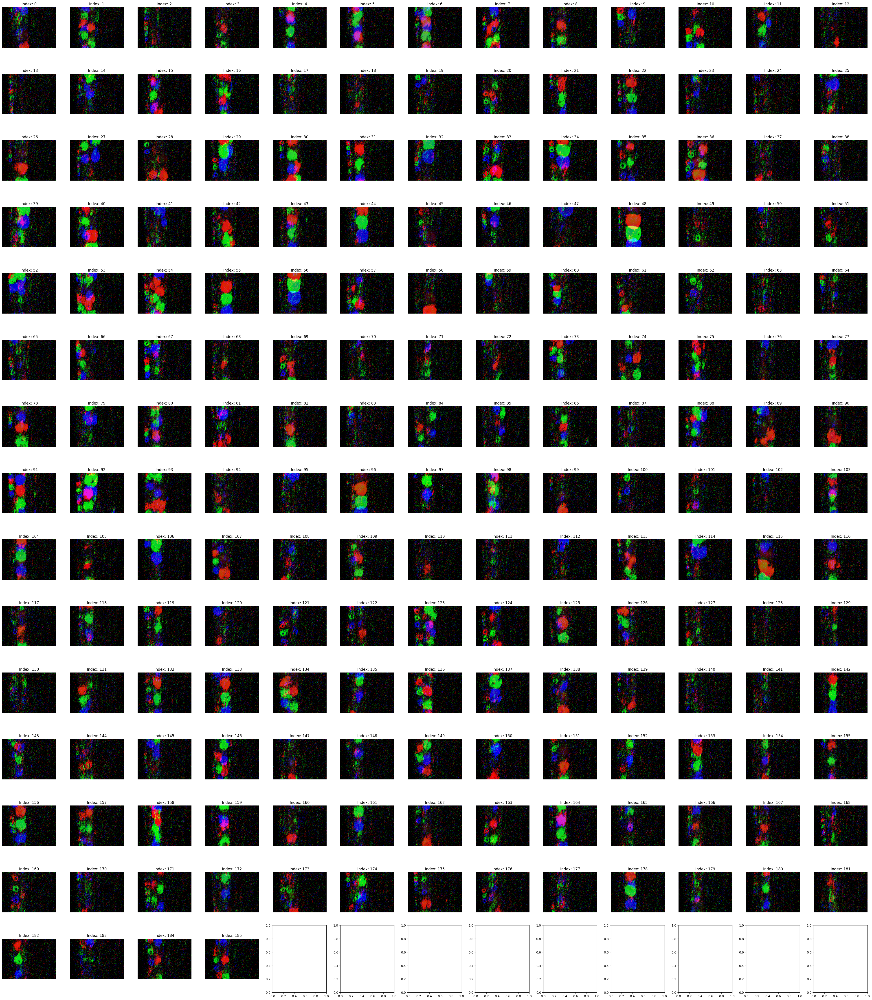

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import math
import torch  # Using torch for tensor operations

# Determine the layout of subplots
n_files = len(acc_files)
n_cols = int(math.sqrt(n_files))
n_rows = int(math.ceil(n_files / n_cols))

# Create a figure with subplots
fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols * 3, n_rows * 3))
axs = axs.flatten()  # Flatten the array of axes to simplify indexing

# Load each file and plot it
for idx, file_path in enumerate(acc_files):
    # Load the tensor from a .npy file
    data = np.load(file_path)  # Corrected to use np.load for numpy arrays
    if isinstance(data, np.ndarray):
        data = torch.from_numpy(data)  # Convert to torch tensor if necessary
    
    # Assume data is in the format [25, 260, 346]
    if data.shape[0] == 25:
        # Sum slices into RGB channels
        # Sum every 8 slices into one channel, ignoring the last one to make it divisible by 3
        channels = [data[i:i+8].sum(dim=0) for i in range(0, 24, 8)]
        img = torch.stack(channels)  # Stack to form a 3-channel image
        img = img.permute(1, 2, 0)  # Reorder dimensions for plotting
        img = img / img.max()  # Normalize for better visualization
        axs[idx].imshow((img.numpy()*255).astype(np.uint8))  # Convert back to numpy array for plotting
    else:
        axs[idx].imshow(data[0], cmap='gray')  # Plot the first channel if not RGB
    
    axs[idx].set_title(f'Index: {idx}')
    axs[idx].axis('off')  # Turn off axis

# Adjust layout
plt.tight_layout()
plt.show()


In [7]:
data.shape

torch.Size([25, 260, 346])

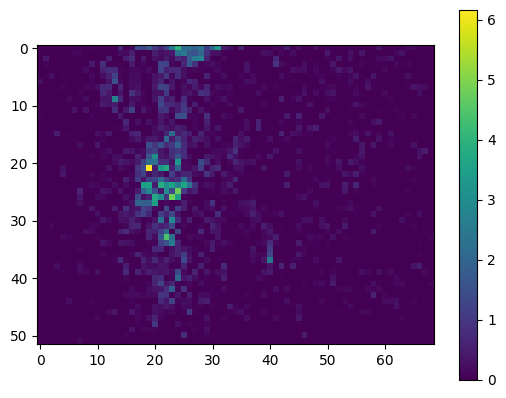

In [2]:
plt.imshow(torch.abs(acc_2d_downscaled)[4,0].detach().cpu())
plt.colorbar()

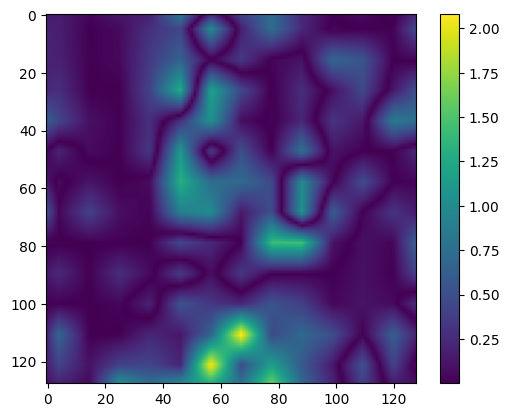

In [3]:
plt.imshow(torch.abs(acc_2d_selected)[4, 0].detach().cpu())
plt.colorbar()

In [4]:
# pooled_acc_2d = F.max_pool2d(acc_2d.unsqueeze(1), kernel_size=(5, 5), stride=(5, 5))


# pooled_acc_2d.shape

# plt.imshow(pooled_acc_2d[4,0].detach().cpu())

prints(acc_2d)
prints(velocities_batch)

velocities_batch[0]

# polarized_matrix[0].shape

prints(acc_selected)

# plt.imshow(acc_3d_roi[1].sum(dim=0).detach().cpu())
# plt.colorbar()

# plt.imshow(polarized_matrix[0].cpu().detach()[0])
# plt.colorbar()

sample_events.shape

# acc_3d_roi.shape

# acc_3d_roi.min()

# plt.imshow(acc_3d_roi[0,0].cpu().detach())
# plt.colorbar()

transforms_sample

velocities_sample

prints(warped_sample)

Tensor Shapes:
acc_2d: 
acc_2d.shape: torch.Size([40, 260, 346])
acc_2d.min: -15.294519424438477
acc_2d.max: 18.548166275024414
Tensor Shapes:
velocities_batch: 
velocities_batch.shape: torch.Size([8, 5, 2])
velocities_batch.min: 0.008101243525743484
velocities_batch.max: 0.2040605992078781


NameError: name 'acc_selected' is not defined

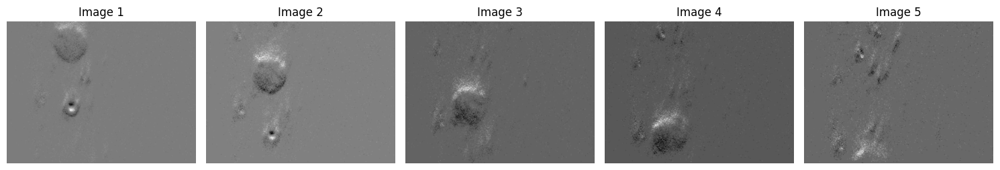

In [30]:
from random import choice

random_idx = choice(range(len(dataset)))
sample_events, = dataset[8]
sample_events = sample_events.unsqueeze(0).to(device)  # Add batch dimension
velocities_sample, transforms_sample = model(sample_events)
# velocities_sample[..., 0] *= 0
velocities_sample
warped_sample = warp_events_based_on_velocity(sample_events, velocities_sample, sensor_size)
acc_sample = batch_events_to_image_3d(warped_sample.view(1 * num_segments, n_events, 4),
                                      sensor_width, sensor_height, total_time, total_time)
warped_sample_roi = warp_events_with_velocity_and_affine(
            sample_events, velocities_sample, transforms_sample, 
            sensor_size, object_min, object_max, target_object_size)
masks = create_theta_and_masks(
    sample_events, velocities_sample, transforms_sample, 
    sensor_size, total_time, total_time,
    object_min, object_max
)

acc_sample_2d = acc_sample.sum(dim=1)
final_reconstructed_images = edge_integration_net(acc_sample_2d, velocities_sample.view(-1, 2))
acc_sample_selected = select_regions(
            acc_sample_2d.unsqueeze(1), transforms_sample, sensor_size, target_object_size, object_min, object_max
        )
        

# Number of images to plot in a row
n_images = acc_sample_2d.shape[0]

# Create subplots
fig, axs = plt.subplots(1, n_images, figsize=(n_images * 3, 3))  # Adjust figsize to make room for all images

# Loop through each image and plot it
for i in range(n_images):
    axs[i].imshow(acc_sample_2d[i].detach().cpu(), cmap='gray')
    axs[i].set_title(f'Image {i+1}')
    axs[i].axis('off')  # Turn off the axis for a cleaner look

plt.tight_layout()
plt.show()

In [31]:
# velocities_sample[..., 0] *= 0
velocities_sample

tensor([[[0.0091, 0.2041],
         [0.0107, 0.1865],
         [0.0081, 0.1862],
         [0.0097, 0.1996],
         [0.0103, 0.2025]]], device='cuda:0', grad_fn=<StackBackward0>)

In [32]:
final_reconstructed_images.shape

torch.Size([5, 261, 347])

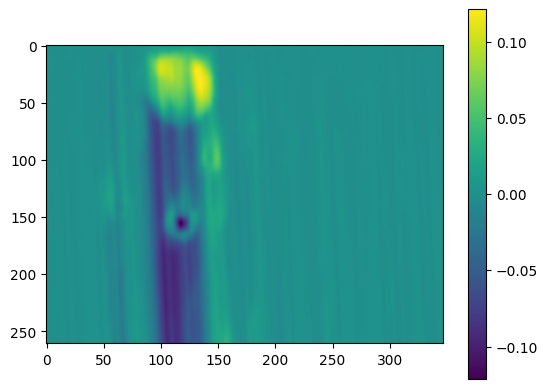

In [35]:
plt.imshow(final_reconstructed_images[0].detach().cpu())
plt.colorbar()

In [36]:
acc_sample_selected.shape

torch.Size([5, 1, 128, 128])

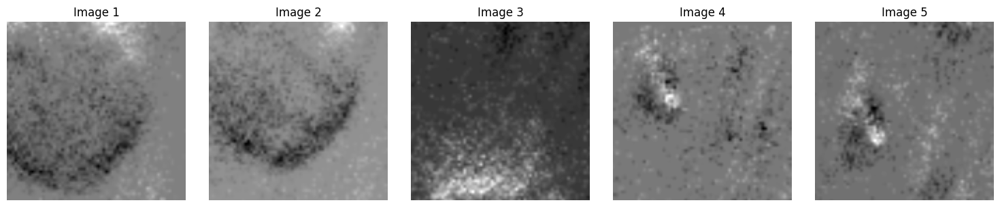

In [37]:
# Number of images to plot in a row
n_images = acc_sample_selected.shape[0]

# Create subplots
fig, axs = plt.subplots(1, n_images, figsize=(n_images * 3, 3))  # Adjust figsize to make room for all images

# Loop through each image and plot it
for i in range(n_images):
    axs[i].imshow(acc_sample_selected[i, 0].detach().cpu(), cmap='gray')
    axs[i].set_title(f'Image {i+1}')
    axs[i].axis('off')  # Turn off the axis for a cleaner look

plt.tight_layout()
plt.show()

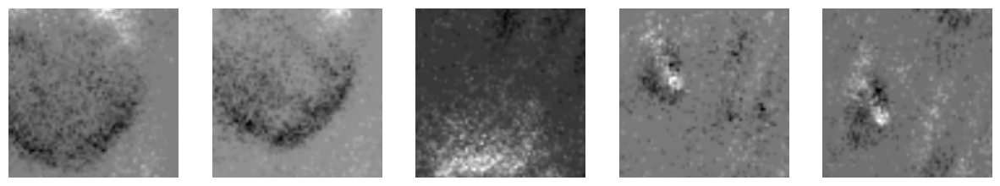

In [38]:
import matplotlib.pyplot as plt

# Assuming acc_sample_selected is a tensor of shape [5, 1, 128, 128]
# acc_sample_selected = torch.rand(5, 1, 128, 128)  # Example data for demonstration

# Create a figure with 5 subplots in a row
fig, axs = plt.subplots(1, 5, figsize=(15, 5))

# Loop through each image in acc_sample_selected and plot it
for i in range(5):
    axs[i].imshow(acc_sample_selected[i, 0].detach().cpu(), cmap='gray')  # Plot each image in grayscale
    axs[i].axis('off')  # Turn off the axis labels for a cleaner display

# Display the plots
plt.show()


In [39]:
masks.shape

torch.Size([5, 1, 260, 346])

In [40]:
velocities_sample

tensor([[[0.0091, 0.2041],
         [0.0107, 0.1865],
         [0.0081, 0.1862],
         [0.0097, 0.1996],
         [0.0103, 0.2025]]], device='cuda:0', grad_fn=<StackBackward0>)

In [41]:
transforms_sample

tensor([[[ 0.0129, -0.2564, -0.6384],
         [ 0.0137, -0.2803, -0.1355],
         [ 0.0172, -0.3042, -0.2635],
         [ 0.0110, -0.3158, -0.7639],
         [ 0.0200, -0.3287, -0.5820]]], device='cuda:0',
       grad_fn=<StackBackward0>)

In [42]:
masks.min()

tensor(0., device='cuda:0', grad_fn=<MinBackward1>)

In [43]:
masks.max()

tensor(1.0000, device='cuda:0', grad_fn=<MaxBackward1>)

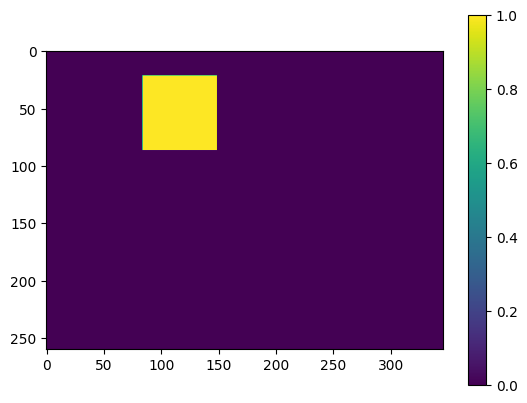

In [44]:
plt.imshow(masks[4,0].detach().cpu())
plt.colorbar()

In [45]:
sample_events[..., -1].min()

sample_events[..., -1].max()

warped_sample_roi.shape

warped_sample.min()

warped_sample.shape

warped_sample[..., -1].min()

warped_sample[..., -1].max()



warped_sample_roi.min()

warped_sample_roi.max()

tensor(49994.9453, device='cuda:0', grad_fn=<MaxBackward1>)

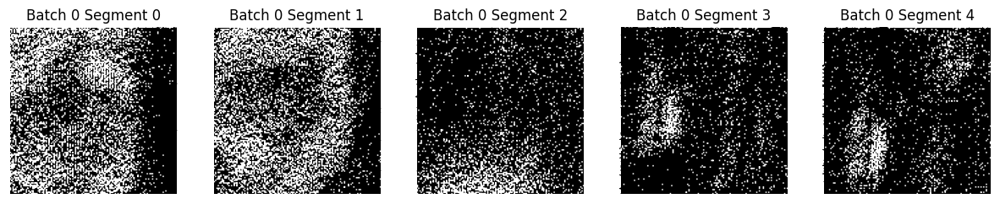

In [46]:
visualize_warped_events(warped_sample_roi.to("cpu"), target_object_size)

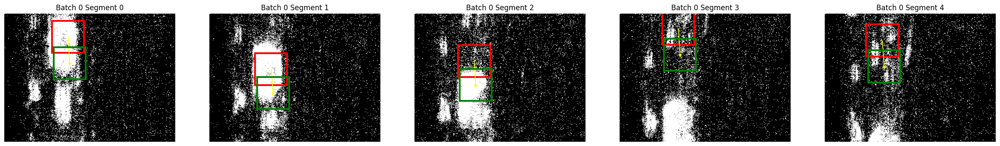

In [47]:
visualize_original_events_with_annotations(
            sample_events, velocities_sample, transforms_sample, sensor_size, save_dir_path, object_min, object_max,debug=True
        )

In [29]:
acc_selected = select_regions(
            acc_2d.unsqueeze(1), transforms_batch, sensor_size, target_object_size, object_min, object_max
        )
        

In [54]:
# import torch
import torch.nn.functional as F

def create_theta_and_masks(events, velocities, transforms, sensor_size, time_resolution, total_time, object_min, object_max):
    batch_size, num_segments, num_events, _ = events.shape
    height, width = sensor_size
    num_slices = int(total_time / time_resolution)
    
    # Get start and end times for each segment
    start_times = events[..., 0].min(dim=2).values
    end_times = events[..., 0].max(dim=2).values

    # Generate timestamps for each time slice within the start and end times
    timestamps = torch.linspace(0, 1, num_slices, device=events.device).view(1, 1, -1)
    timestamps = start_times.unsqueeze(-1) + timestamps * (end_times - start_times).unsqueeze(-1)
    
    # prints(timestamps)

    # Expand velocities to match the timestamps shape
    velocities = velocities.unsqueeze(2).expand(-1, -1, num_slices, -1)
    
    # prints(velocities)
    
    # Time deltas from start times
    time_deltas = timestamps - start_times.unsqueeze(-1)

    # Duration for normalization (end - start for each segment)
    duration = (end_times - start_times).unsqueeze(-1).unsqueeze(-1)

    prints(velocities, duration)
    
    prints(velocities, time_deltas)
    # Calculate shifts due to velocities
    shifts_due_to_velocity = velocities * time_deltas.unsqueeze(-1) / duration

    # Incorporate initial shifts from the transforms tensor
    initial_shifts_x = transforms[:, :, 1].unsqueeze(-1).expand(-1, -1, num_slices) 
    initial_shifts_y = transforms[:, :, 2].unsqueeze(-1).expand(-1, -1, num_slices) 
    
    prints(initial_shifts_x)

    # Final shifts including velocity influence
    final_shifts_x = initial_shifts_x + shifts_due_to_velocity[..., 0]
    final_shifts_y = initial_shifts_y + shifts_due_to_velocity[..., 1]

    # Scales
    scale_factors = transforms[:, :, 0].unsqueeze(-1).expand(-1, -1, num_slices)
    scales_x = ( object_min + scale_factors * (object_max - object_min) ) / width
    scales_y = ( object_min + scale_factors * (object_max - object_min) ) / height


    # Create theta matrices
    theta = torch.zeros(batch_size * num_segments * num_slices, 2, 3, device=events.device)
    theta[:, 0, 0] = 1 / scales_x.reshape(-1)
    theta[:, 1, 1] = 1 / scales_y.reshape(-1)
    theta[:, 0, 2] = -final_shifts_x.view(-1) / scales_x.reshape(-1)  # normalize to [-1, 1]
    theta[:, 1, 2] = -final_shifts_y.view(-1) / scales_y.reshape(-1) # normalize to [-1, 1]

    
    
    # print(theta)
    
    # Generate a base grid and create masks
    grid = F.affine_grid(theta, [batch_size * num_segments * num_slices, 1, height, width], align_corners=True)
    masks = F.grid_sample(
        torch.ones(batch_size * num_segments * num_slices, 1, height, width, device=events.device), 
        grid, mode='bilinear', padding_mode='zeros', align_corners=True
    )

    return masks.view(batch_size*num_segments, num_slices, height, width)

# Example usage
batch_size = 1
num_segments = 5
num_events = 45784
sensor_size = (260, 346)
time_resolution = 1000.0  # microseconds
total_time = 10000.0  # microseconds
object_min, object_max = 64, 128

In [57]:
masks = create_theta_and_masks(
    sample_events, velocities_sample, transforms_sample, 
    sensor_size, time_resolution*10, total_time,
    object_min, object_max
)
print("Masks shape:", masks.shape)

Tensor Shapes:
velocities: 
velocities.shape: torch.Size([1, 5, 1, 2])
velocities.min: 0.010739386081695557
velocities.max: 0.19599469006061554
duration: 
duration.shape: torch.Size([1, 5, 1, 1])
duration.min: 49996.13671875
duration.max: 49998.046875
Tensor Shapes:
velocities: 
velocities.shape: torch.Size([1, 5, 1, 2])
velocities.min: 0.010739386081695557
velocities.max: 0.19599469006061554
time_deltas: 
time_deltas.shape: torch.Size([1, 5, 1])
time_deltas.min: 0.0
time_deltas.max: 0.0
Tensor Shapes:
initial_shifts_x: 
initial_shifts_x.shape: torch.Size([1, 5, 1])
initial_shifts_x.min: -0.21477572619915009
initial_shifts_x.max: 0.6499245166778564
Masks shape: torch.Size([5, 1, 260, 346])


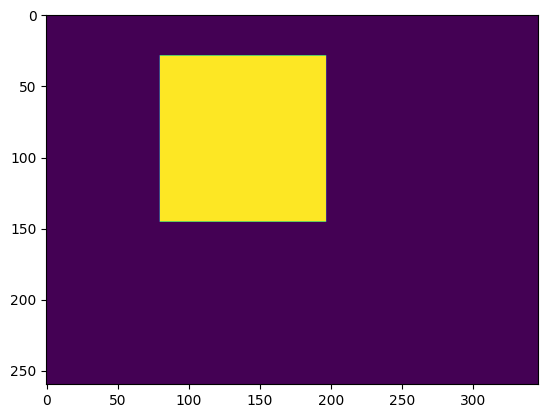

In [58]:
plt.imshow(masks[4,0].detach().cpu())

In [6]:
acc_sample.shape

torch.Size([5, 1, 260, 346])

In [7]:
50/260

0.19230769230769232

In [8]:
velocities_sample

tensor([[[0.4413, 0.4754],
         [0.4483, 0.4964],
         [0.5252, 0.4731],
         [0.5299, 0.5112],
         [0.4914, 0.5030]]], device='cuda:0', grad_fn=<StackBackward0>)

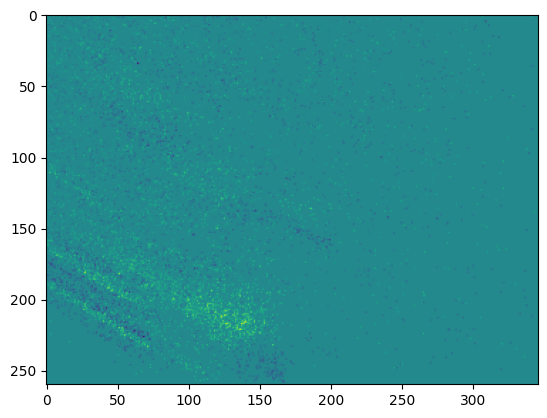

In [9]:
plt.imshow(acc_sample[0,0].detach().cpu())

In [ ]:
# Final Visualization (for the last batch in the final epoch)
gradient_final = frame_processor(frames_batch, velocities_batch)
fig, axes = plt.subplots(5, 5, figsize=(15, 15))
axes = axes.flatten()

for j in range(25):
    axes[j].imshow(gradient_final[0, j].detach().cpu().numpy(), cmap='gray')
    axes[j].axis('off')
    axes[j].set_title(f"Final Gradient dI/dt {j + 1}")

plt.tight_layout()
plt.show()

In [ ]:
# # Training Loop with Batching
# batch_size = 4
# optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
# criterion = nn.MSELoss()

# # Smooth and normalize the accumulated frames
# acc_frames = torch.stack([torch.tensor(np.load(f), dtype=torch.float32) for f in acc_files]).to(device)
# acc_frames_smoothed = smooth_normalize(acc_frames)

# # Create DataLoader for batched training
# dataset = TensorDataset(segmented_events_tensor, acc_frames_smoothed)
# dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# for epoch in range(100):  # Adjust number of epochs as needed
#     model.train()
#     running_loss = 0.0
    
#     for i, (segmented_events_batch, acc_frames_smoothed_batch) in enumerate(dataloader):
#         optimizer.zero_grad()
        
#         frames_batch, velocities_batch = model(segmented_events_batch)
#         predicted_gradient_batch = frame_processor(frames_batch, velocities_batch)
        
#         # Normalize the predicted gradients
#         predicted_gradient_normalized_batch = smooth_normalize(predicted_gradient_batch)
        
#         # Compute the loss
#         loss = criterion(predicted_gradient_normalized_batch, acc_frames_smoothed_batch)
#         loss.backward()
#         optimizer.step()
        
#         running_loss += loss.item()
    
#     print(f"Epoch {epoch + 1}, Loss: {running_loss / len(dataloader)}")
    
# # Final Visualization
# gradient_final = frame_processor(frames_batch, velocities_batch)
# plt.figure(figsize=(10, 4))
# plt.subplot(1, 2, 1)
# plt.imshow(frames_batch[0, 0].detach().cpu().numpy(), cmap='gray')
# plt.title("Final Inferred Frame")

# plt.subplot(1, 2, 2)
# plt.imshow(gradient_final[0, 0].detach().cpu().numpy(), cmap='gray')
# plt.title("Final Gradient dI/dt")
# plt.show()


In [ ]:
# # Training Loop
# optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
# criterion = nn.MSELoss()

# # Smooth and normalize the accumulated frames
# acc_frames = torch.stack([torch.tensor(np.load(f), dtype=torch.float32) for f in acc_files]).to(device)
# acc_frames_smoothed = smooth_normalize(acc_frames)

# for epoch in range(100):  # Adjust number of epochs as needed
#     model.train()
#     optimizer.zero_grad()

#     frames, velocities = model(segmented_events_tensor)
#     predicted_gradient = frame_processor(frames, velocities)
    
    
#     # Normalize the predicted gradients
#     predicted_gradient_normalized = smooth_normalize(predicted_gradient)
    
#     # Compute the loss
#     loss = criterion(predicted_gradient_normalized, acc_frames_smoothed)
#     loss.backward()
#     optimizer.step()
    
#     print(f"Epoch {epoch + 1}, Loss: {loss.item()}")

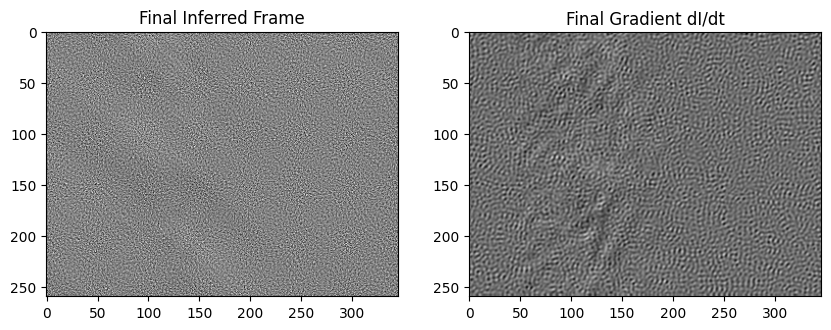

In [5]:
# Final Visualization
gradient_final = frame_processor(frames_batch, velocities_batch)
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(frames_batch[0, 0].detach().cpu().numpy(), cmap='gray')
plt.title("Final Inferred Frame")

plt.subplot(1, 2, 2)
plt.imshow(gradient_final[0, 0].detach().cpu().numpy(), cmap='gray')
plt.title("Final Gradient dI/dt")
plt.show()